In [1]:
from training_utility_functions import *

import pandas as pd
import pickle
import time

from sklearn.model_selection import train_test_split, KFold, GridSearchCV

from sklearn.linear_model import LinearRegression, Ridge, Lasso
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from xgboost import XGBRegressor

RANDOM_STATE = 31415

In [2]:
df_train = pd.read_parquet("data/df_train_cleaned.parquet")
df_train

,id,professionality,visual,grammar,ai_likelihood,education,experience,languages,points_9m
0,CVANON0002,-2.345824,-2.376936,-0.865650,-0.649081,-0.811672,-0.451910,-0.263813,3617.798
1,CVANON0247,0.371492,0.604539,1.070907,0.220367,0.313777,-0.658899,0.169880,1271.650
2,CVANON0009,0.371492,0.604539,-0.220131,1.089815,0.735821,-0.625678,0.386726,2569.874
3,CVANON0238,0.371492,0.604539,-0.865650,0.220367,2.001951,-0.431466,-1.998586,685.200
4,CVANON0269,0.371492,0.604539,1.070907,-0.649081,0.313777,-0.508129,0.820419,652.800
...,...,...,...,...,...,...,...,...,...
283,CVANON0311,0.371492,0.604539,1.070907,0.220367,1.720589,-0.416134,0.386726,41.600
284,CVANON0318,-1.440052,-1.383111,-2.156688,1.959263,-0.530310,-0.326694,-0.263813,164.000
285,CVANON0210,1.277264,1.598363,-0.220131,1.089815,-0.389628,7.955434,1.904652,2292.700
286,CVANON0206,0.371492,0.604539,1.070907,-0.649081,0.454458,0.031065,1.687805,82.500


In [3]:
X_train_orig = df_train.iloc[:, 1:].copy()
X_train_orig

,professionality,visual,grammar,ai_likelihood,education,experience,languages,points_9m
0,-2.345824,-2.376936,-0.865650,-0.649081,-0.811672,-0.451910,-0.263813,3617.798
1,0.371492,0.604539,1.070907,0.220367,0.313777,-0.658899,0.169880,1271.650
2,0.371492,0.604539,-0.220131,1.089815,0.735821,-0.625678,0.386726,2569.874
3,0.371492,0.604539,-0.865650,0.220367,2.001951,-0.431466,-1.998586,685.200
4,0.371492,0.604539,1.070907,-0.649081,0.313777,-0.508129,0.820419,652.800
...,...,...,...,...,...,...,...,...
283,0.371492,0.604539,1.070907,0.220367,1.720589,-0.416134,0.386726,41.600
284,-1.440052,-1.383111,-2.156688,1.959263,-0.530310,-0.326694,-0.263813,164.000
285,1.277264,1.598363,-0.220131,1.089815,-0.389628,7.955434,1.904652,2292.700
286,0.371492,0.604539,1.070907,-0.649081,0.454458,0.031065,1.687805,82.500


# Train-test split

In [4]:
target = "points_9m"

In [5]:
X_train, X_temp, y_train, y_temp = train_test_split(X_train_orig.drop(columns=[target]), X_train_orig[target], test_size=0.25, random_state=31415)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.2, random_state=31415)

# Models training and selection

In [12]:
models = {
    "Linear Regression": LinearRegression(fit_intercept=True),
    "Ridge Regression": Ridge(alpha=1.0),
    "Lasso Regression": Lasso(alpha=0.1),
    "Decision Tree Regressor": DecisionTreeRegressor(max_depth=5, random_state=RANDOM_STATE),
    "Random Forest Regressor": RandomForestRegressor(n_estimators=100, random_state=RANDOM_STATE),
	"Gradient Boosting Regressor": GradientBoostingRegressor(n_estimators=100, learning_rate=0.1, random_state=RANDOM_STATE),
    "XGBoost Regressor": XGBRegressor(n_estimators=100, learning_rate=0.1, max_depth=3, random_state=RANDOM_STATE)
}

In [13]:
configurations = {}

# Base hyperparameters

In [14]:
configuration = "Base hyperparameters"

In [15]:
# Initialize the configuration
configurations[configuration] = {
    "hyperparams_to_optimize": {},
    "hyperparams_searcher": {},
    "hyperparams_optimized": {},
    "models_optimized": {},
    "scores": {}
}

In [16]:
for name, model in models.items():
    configurations[configuration]["scores"][name] = evaluate_regression_model(
		model,
		X_train,
		y_train,
		X_val,
		y_val,
	)

Fitting model LinearRegression()...
	Predicting and scoring on dataset 'train'...
	Predicting and scoring on dataset 'val'...
	Predicting and scoring on dataset 'test'...
	Predicting and scoring on dataset 'predict'...
Fitting model Ridge()...
	Predicting and scoring on dataset 'train'...
	Predicting and scoring on dataset 'val'...
	Predicting and scoring on dataset 'test'...
	Predicting and scoring on dataset 'predict'...
Fitting model Lasso(alpha=0.1)...
	Predicting and scoring on dataset 'train'...
	Predicting and scoring on dataset 'val'...
	Predicting and scoring on dataset 'test'...
	Predicting and scoring on dataset 'predict'...
Fitting model DecisionTreeRegressor(max_depth=5, random_state=31415)...
	Predicting and scoring on dataset 'train'...
	Predicting and scoring on dataset 'val'...
	Predicting and scoring on dataset 'test'...
	Predicting and scoring on dataset 'predict'...
Fitting model RandomForestRegressor(random_state=31415)...
	Predicting and scoring on dataset 'train'

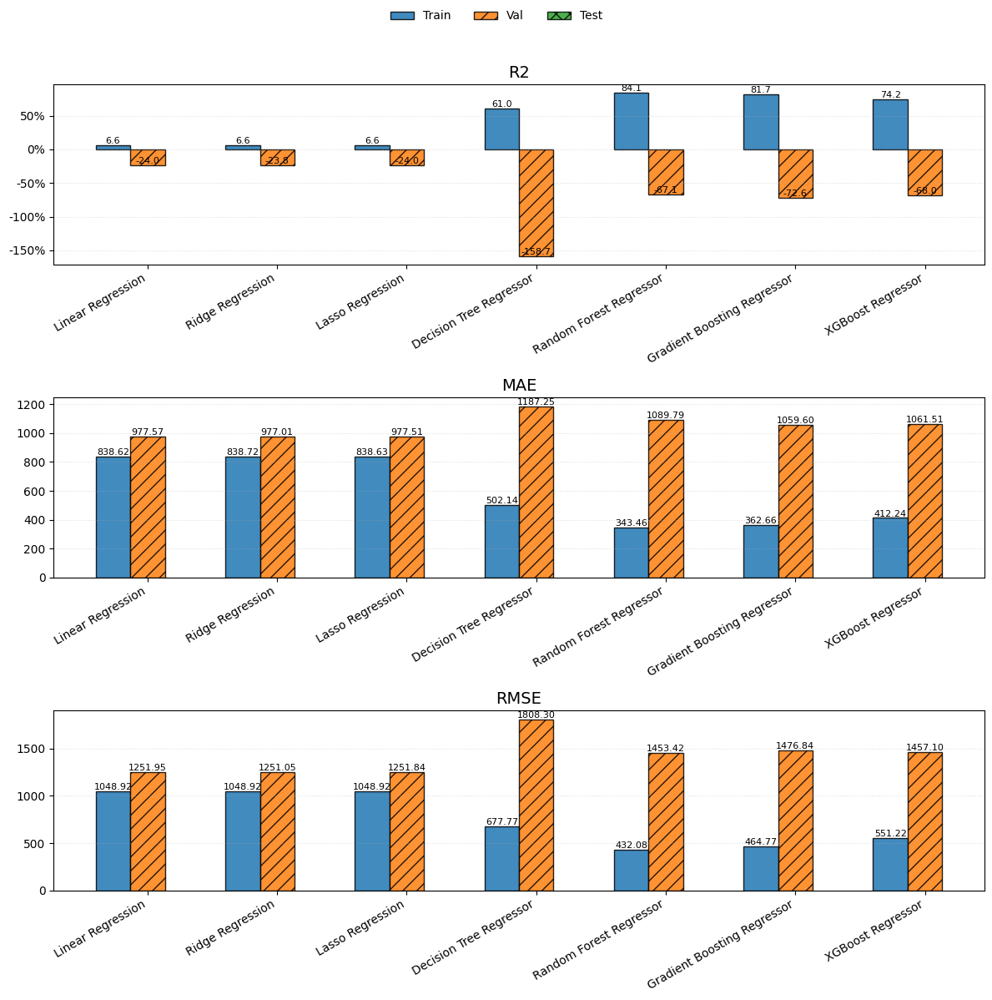

In [17]:
barplot_regression_models_scores(
    configurations[configuration]["scores"],
    plot_datasets=("train", "val", "test"),
    plot_metrics=("r2", "mae", "rmse")
)

# Fine tuning of models

In [18]:
def configure_searchers(models, params_to_optimize, cv, strategy=GridSearchCV, scoring="r2", n_jobs=-1, verbose=2, **kwargs):
    searchers = {}
    for name, model in models.items():
        searchers[name] = strategy(model, params_to_optimize[name], cv=cv, scoring=scoring, n_jobs=n_jobs, verbose=verbose, **kwargs)
    return searchers

In [19]:
# Define cross-validation
cv = KFold(n_splits=5, shuffle=True, random_state=RANDOM_STATE)

In [20]:
configuration = "GridSearchCV"

In [21]:
# Define the parameters to optimize
params_to_optimize = {
    # ------------------------------------------------------------------
    # 1. Linear Regression (few tunables, but worth toggling)
    # ------------------------------------------------------------------
    "Linear Regression": {
        "fit_intercept": [True, False],
        "positive": [False, True],                 # force-positive coefficients
        "copy_X": [True, False],
    },

    # ------------------------------------------------------------------
    # 2. Ridge Regression
    # ------------------------------------------------------------------
    "Ridge Regression": {
        "alpha": [1e-3, 1e-2, 1e-1, 1, 10, 100],   # L2 strength
        "fit_intercept": [True, False],
        "solver": ["auto", "svd", "lbfgs", "sag"],
        "positive": [False, True],
    },

    # ------------------------------------------------------------------
    # 3. Lasso Regression
    # ------------------------------------------------------------------
    "Lasso Regression": {
        "alpha": [1e-3, 1e-2, 1e-1, 1, 10],        # L1 strength
        "fit_intercept": [True, False],
        "selection": ["cyclic", "random"],
        "max_iter": [1_000, 5_000, 10_000],
        "tol": [1e-4, 1e-3],
        "positive": [False, True],
    },

    # ------------------------------------------------------------------
    # 4. Decision Tree Regressor
    # ------------------------------------------------------------------
    "Decision Tree Regressor": {
        "criterion": ["squared_error", "friedman_mse", "absolute_error"],
        "max_depth": [None, 3, 5, 8, 12],
        "min_samples_split": [2, 5, 10, 20],
        "min_samples_leaf": [1, 2, 4, 10],
        "max_features": [None, "sqrt", "log2", 0.5],  # 0.5 ⇒ 50 % of features
        "ccp_alpha": [0.0, 0.0001, 0.001],
    },

    # ------------------------------------------------------------------
    # 5. Random Forest Regressor
    # ------------------------------------------------------------------
    "Random Forest Regressor": {
        "n_estimators": [100, 300, 600],
        "max_depth": [None, 5, 10, 20],
        "min_samples_split": [2, 5, 10],
        "min_samples_leaf": [1, 2, 4],
        "max_features": ["sqrt", "log2", 0.33],
        "bootstrap": [True, False],
        "criterion": ["squared_error", "absolute_error"],
    },

    # ------------------------------------------------------------------
    # 6. Gradient Boosting Regressor
    # ------------------------------------------------------------------
    "Gradient Boosting Regressor": {
        "n_estimators": [100, 300, 600],
        "learning_rate": [0.01, 0.05, 0.1],
        "max_depth": [2, 3, 5],
        "min_samples_split": [2, 5, 10],
        "min_samples_leaf": [1, 2, 4],
        "subsample": [0.6, 0.8, 1.0],
        "loss": ["squared_error", "absolute_error", "huber"],
    },

    # ------------------------------------------------------------------
    # 7. XGBoost Regressor
    # ------------------------------------------------------------------
    "XGBoost Regressor": {
        "n_estimators": [100, 300, 600],
        "learning_rate": [0.01, 0.05, 0.1],
        "max_depth": [3, 5, 7, 10],
        "subsample": [0.6, 0.8, 1.0],
        "colsample_bytree": [0.6, 0.8, 1.0],
        "gamma": [0, 0.1, 0.3],
        "min_child_weight": [1, 5, 10],
        "reg_alpha": [0, 0.001, 0.01],             # L1 regularization
        "reg_lambda": [1, 1.5, 2.0],               # L2 regularization
    },
}

In [22]:
# Initialize the configuration
configurations[configuration] = {
    "hyperparams_to_optimize": params_to_optimize,
    "hyperparams_searcher": {
        "strategy": GridSearchCV,
        "kwargs": {},
        "searchers": {},
        "search_time": {}
    },
    "hyperparams_optimized": {},
    "models_optimized": {},
    "scores": {}
}
# Initialize the searchers
configurations[configuration]["hyperparams_searcher"]["searchers"] = configure_searchers(
    models=models,
    params_to_optimize=configurations[configuration]["hyperparams_to_optimize"],
    strategy=configurations[configuration]["hyperparams_searcher"]["strategy"],
    cv=cv, scoring="r2", **configurations[configuration]["hyperparams_searcher"]["kwargs"]
)   

In [23]:
# Search hyperparameters
for name, searcher in configurations[configuration]["hyperparams_searcher"]["searchers"].items():
    start_time = time.time()
    searcher.fit(X_train, y_train)
    end_time = time.time()
    configurations[configuration]["hyperparams_searcher"]["search_time"][name] = end_time - start_time
    configurations[configuration]["hyperparams_optimized"][name] = searcher.best_params_

Fitting 5 folds for each of 8 candidates, totalling 40 fits


[CV] END ....copy_X=True, fit_intercept=True, positive=False; total time=   0.0s
[CV] END ....copy_X=True, fit_intercept=True, positive=False; total time=   0.0s
[CV] END ....copy_X=True, fit_intercept=True, positive=False; total time=   0.0s
[CV] END ....copy_X=True, fit_intercept=True, positive=False; total time=   0.0s
[CV] END ....copy_X=True, fit_intercept=True, positive=False; total time=   0.0s
[CV] END .....copy_X=True, fit_intercept=True, positive=True; total time=   0.0s
[CV] END .....copy_X=True, fit_intercept=True, positive=True; total time=   0.0s
[CV] END .....copy_X=True, fit_intercept=True, positive=True; total time=   0.0s
[CV] END .....copy_X=True, fit_intercept=True, positive=True; total time=   0.0s
[CV] END .....copy_X=True, fit_intercept=True, positive=True; total time=   0.0s
[CV] END ...copy_X=True, fit_intercept=False, positive=False; total time=   0.0s
[CV] END ...copy_X=True, fit_intercept=False, positive=False; total time=   0.0s
[CV] END ...copy_X=True, fit

/home/ruben/recruitment_model/.venv/lib/python3.10/site-packages/sklearn/model_selection/_validation.py:528: FitFailedWarning: 
180 fits failed out of a total of 480.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
60 fits failed with the following error:
Traceback (most recent call last):
  File "/home/ruben/recruitment_model/.venv/lib/python3.10/site-packages/sklearn/model_selection/_validation.py", line 866, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/home/ruben/recruitment_model/.venv/lib/python3.10/site-packages/sklearn/base.py", line 1389, in wrapper
    return fit_method(estimator, *args, **kwargs)
  File "/home/ruben/recruitment_model/.venv/lib/python3.10/site-packages/sklearn/linear_model/_ridge.

[CV] END alpha=0.001, fit_intercept=False, max_iter=5000, positive=False, selection=cyclic, tol=0.001; total time=   0.0s
[CV] END alpha=0.001, fit_intercept=False, max_iter=1000, positive=False, selection=cyclic, tol=0.001; total time=   0.0s
[CV] END alpha=0.001, fit_intercept=False, max_iter=1000, positive=True, selection=random, tol=0.001; total time=   0.0s
[CV] END alpha=0.001, fit_intercept=False, max_iter=1000, positive=True, selection=cyclic, tol=0.0001; total time=   0.0s
[CV] END alpha=0.001, fit_intercept=False, max_iter=5000, positive=False, selection=random, tol=0.0001; total time=   0.0s
[CV] END alpha=0.001, fit_intercept=False, max_iter=1000, positive=False, selection=cyclic, tol=0.001; total time=   0.0s
[CV] END alpha=0.001, fit_intercept=False, max_iter=5000, positive=False, selection=cyclic, tol=0.0001; total time=   0.0s
[CV] END alpha=0.001, fit_intercept=False, max_iter=1000, positive=True, selection=cyclic, tol=0.0001; total time=   0.0s
[CV] END alpha=0.001, f

In [24]:
# Configure and save the models with the optimized hyperparameters
configurations[configuration]["models_optimized"] = {name: models[name].set_params(**configurations[configuration]["hyperparams_optimized"][name]) for name in models.keys()}

In [25]:
# Summary of the search
print(f"Summary of the search for {configuration}")
for name, searcher in configurations[configuration]["hyperparams_searcher"]["searchers"].items():
    print(f"\t{name}:")
    print(f"\t\tBest parameters: {configurations[configuration]['hyperparams_optimized'][name]}")
    print(f"\t\tBest score: {searcher.best_score_}")
    print(f"\t\tSearch time: {configurations[configuration]['hyperparams_searcher']['search_time'][name]:.2f} seconds")

Summary of the search for GridSearchCV
	Linear Regression:
		Best parameters: {'copy_X': True, 'fit_intercept': True, 'positive': True}
		Best score: -0.1429012901216145
		Search time: 0.94 seconds
	Ridge Regression:
		Best parameters: {'alpha': 100, 'fit_intercept': True, 'positive': False, 'solver': 'auto'}
		Best score: -0.11942707017747071
		Search time: 0.53 seconds
	Lasso Regression:
		Best parameters: {'alpha': 10, 'fit_intercept': True, 'max_iter': 5000, 'positive': True, 'selection': 'random', 'tol': 0.0001}
		Best score: -0.14135257334045676
		Search time: 0.98 seconds
	Decision Tree Regressor:
		Best parameters: {'ccp_alpha': 0.0, 'criterion': 'squared_error', 'max_depth': 5, 'max_features': 'sqrt', 'min_samples_leaf': 10, 'min_samples_split': 2}
		Best score: -0.17988228229056863
		Search time: 11.12 seconds
	Random Forest Regressor:
		Best parameters: {'bootstrap': True, 'criterion': 'absolute_error', 'max_depth': 10, 'max_features': 'sqrt', 'min_samples_leaf': 4, 'min_sam

In [26]:
# Score the models
for name, model in models.items():
    model.set_params(**configurations[configuration]["hyperparams_optimized"][name])
    configurations[configuration]["scores"][name] = evaluate_regression_model(model, X_train, y_train, X_val, y_val, X_test, y_test)

Fitting model LinearRegression(positive=True)...
	Predicting and scoring on dataset 'train'...
	Predicting and scoring on dataset 'val'...
	Predicting and scoring on dataset 'test'...
	Predicting and scoring on dataset 'predict'...
Fitting model Ridge(alpha=100)...
	Predicting and scoring on dataset 'train'...
	Predicting and scoring on dataset 'val'...
	Predicting and scoring on dataset 'test'...
	Predicting and scoring on dataset 'predict'...
Fitting model Lasso(alpha=10, max_iter=5000, positive=True, selection='random')...
	Predicting and scoring on dataset 'train'...
	Predicting and scoring on dataset 'val'...
	Predicting and scoring on dataset 'test'...
	Predicting and scoring on dataset 'predict'...
Fitting model DecisionTreeRegressor(max_depth=5, max_features='sqrt', min_samples_leaf=10,
                      random_state=31415)...
	Predicting and scoring on dataset 'train'...
	Predicting and scoring on dataset 'val'...
	Predicting and scoring on dataset 'test'...
	Predicting an

	Predicting and scoring on dataset 'train'...
	Predicting and scoring on dataset 'val'...
	Predicting and scoring on dataset 'test'...
	Predicting and scoring on dataset 'predict'...
Fitting model GradientBoostingRegressor(learning_rate=0.01, loss='huber', max_depth=2,
                          min_samples_leaf=4, min_samples_split=10,
                          random_state=31415, subsample=0.6)...
	Predicting and scoring on dataset 'train'...
	Predicting and scoring on dataset 'val'...
	Predicting and scoring on dataset 'test'...
	Predicting and scoring on dataset 'predict'...
Fitting model XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=0.6, device=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             feature_weights=None, gamma=0, grow_policy=None,
             importance_type=None, interaction_constraints=None,
 

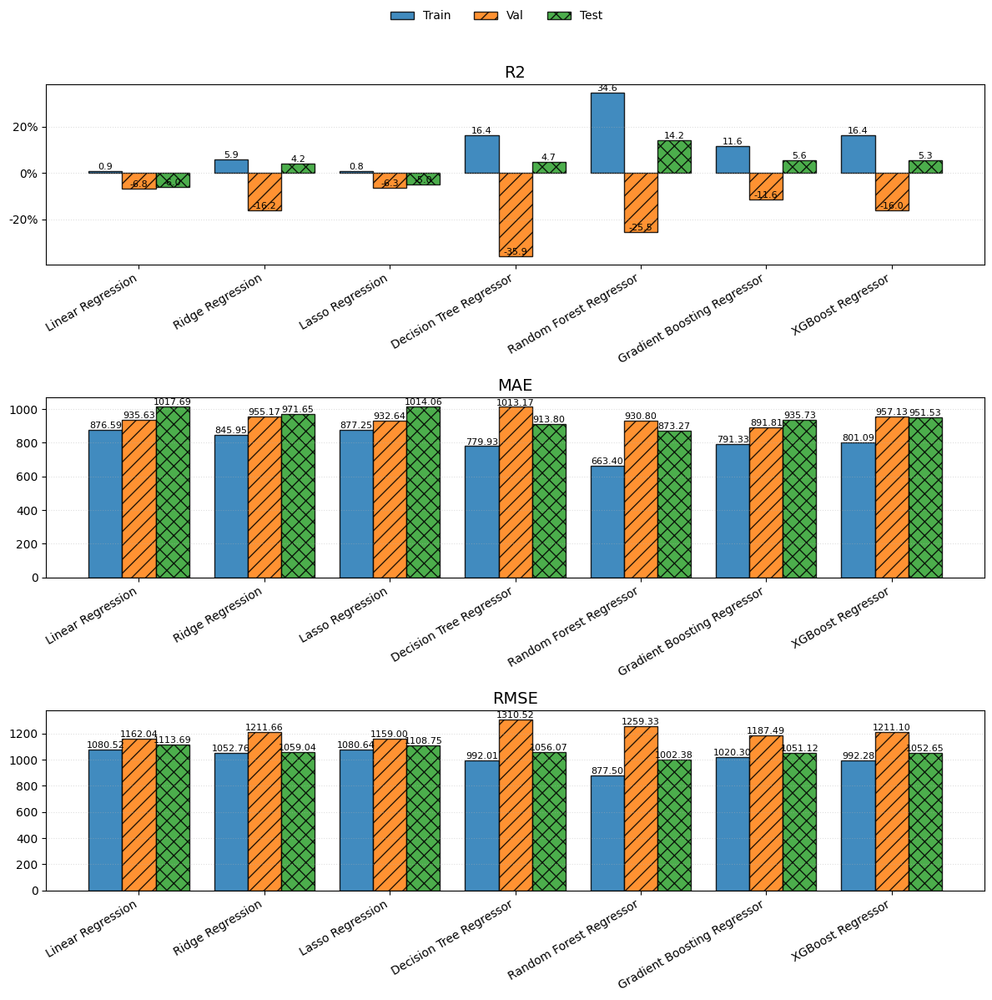

In [27]:
barplot_regression_models_scores(
    configurations[configuration]["scores"],
    plot_datasets=("train", "val", "test"),
    plot_metrics=("r2", "mae", "rmse")
)

# Train and evaluate final model

In [28]:
selected_model = "Random Forest Regressor"
selected_configuration = "GridSearchCV"

In [29]:
with open("model/model.pkl", "wb") as f:
    pickle.dump(configurations[selected_configuration]["models_optimized"][selected_model], f)
with open("model/models_configurations.pkl", "wb") as f:
    pickle.dump(configurations, f)

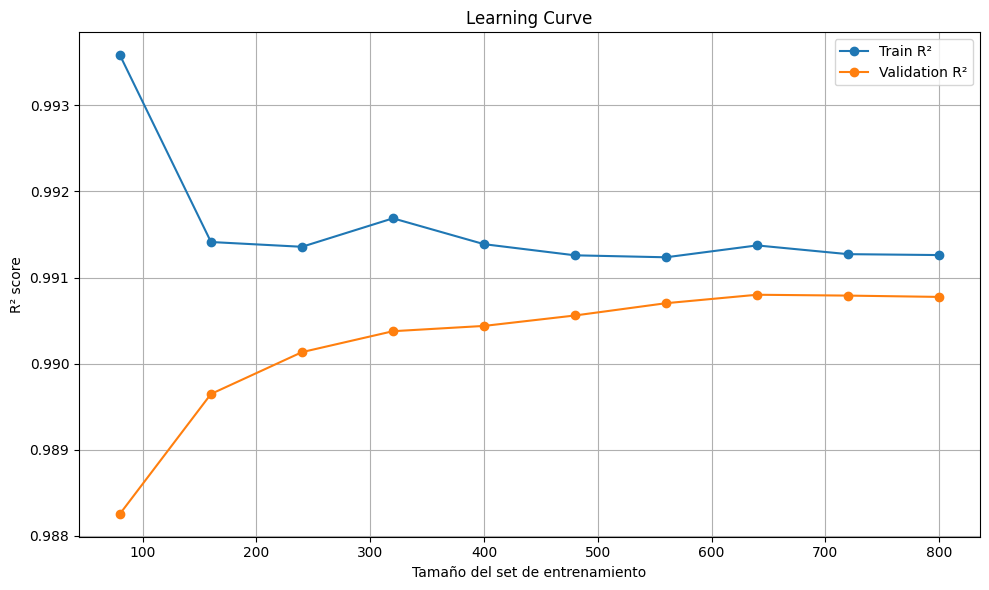

In [30]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import learning_curve
from sklearn.linear_model import Ridge
from sklearn.datasets import make_regression

# Ejemplo con datos sintéticos
X, y = make_regression(n_samples=1000, n_features=20, noise=15)

# Modelo
model = Ridge(alpha=1.0)

# Calcular curva de aprendizaje
train_sizes, train_scores, val_scores = learning_curve(
    estimator=model,
    X=X,
    y=y,
    train_sizes=np.linspace(0.1, 1.0, 10),
    cv=5,
    scoring='r2',
    shuffle=True,
    random_state=42
)

# Media y desviación estándar de scores
train_scores_mean = np.mean(train_scores, axis=1)
val_scores_mean = np.mean(val_scores, axis=1)

# Graficar
plt.figure(figsize=(10, 6))
plt.plot(train_sizes, train_scores_mean, 'o-', label='Train R²')
plt.plot(train_sizes, val_scores_mean, 'o-', label='Validation R²')
plt.xlabel('Tamaño del set de entrenamiento')
plt.ylabel('R² score')
plt.title('Learning Curve')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()
